In [1]:
import os
from os.path import isfile, join

import re

import numpy as np
import pandas as pd
import seaborn as sns

In [36]:
path = '../data/graphs/kw33/results'

def build_df_from_csvs(path: str) -> pd.DataFrame:
    files = os.listdir(path)
    df = pd.DataFrame()

    for current_file in files:
    # current_file = files[0]
        df_tmp = pd.read_csv(join(path, current_file), delimiter=',\t')
        
        prefix = [re.findall(r'(\w+?)(\d+\.\d+|\d+)', identifier)[0] for identifier in current_file.split('-')[0].split('_')]
        for cn, cv in prefix:
            df_tmp[cn] = pd.to_numeric(cv)

        suffix = current_file.split('-')[2].split('_')
        if len(suffix) == 3:
            suffix[1] = '{}_{}'.format(suffix[1], suffix[2])
            suffix.pop(2)
        suffix[1] = suffix[1].split('.')[0]
        df_tmp['Sampling'] = suffix[0]
        df_tmp['Clustering'] = suffix[1]
        
        df = pd.concat([df, df_tmp])

    # postprocess
    df['jsd'] = df['jsd'].apply(lambda x: 1 - x)
    df.rename(columns = {'jsd':'ijsd'}, inplace = True)

    return df

df = build_df_from_csvs(path)
df.head()

,Checkpoint,bootstrap_jsd,gambette,cluster_number,ijsd,ari,n,k,log,Sampling,Clustering
0,10,0.000000,0.994230,1,0.974538,1.000000,100,3,0.3,modifiedrandomwalk,cw
1,20,0.000000,0.978541,1,0.974538,1.000000,100,3,0.3,modifiedrandomwalk,cw
2,30,0.013543,0.976104,3,0.792277,0.000000,100,3,0.3,modifiedrandomwalk,cw
3,40,0.015185,0.956944,2,0.931105,-0.061798,100,3,0.3,modifiedrandomwalk,cw
4,50,0.025176,0.951358,3,0.845357,-0.034217,100,3,0.3,modifiedrandomwalk,cw


In [37]:
sns.set_theme(style="darkgrid")
checkpoints = [10, 20, 30, 40, 50, 100, 200, 300, 400, 500, 1000, 2000,  3000, 4000, 5000]

df_sampling_allk_alllog = pd.melt(df, id_vars=['Checkpoint', 'Sampling'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_allk_alllog.head()

,Checkpoint,Sampling,Measure,Performance
0,10,modifiedrandomwalk,ari,1.000000
1,20,modifiedrandomwalk,ari,1.000000
2,30,modifiedrandomwalk,ari,0.000000
3,40,modifiedrandomwalk,ari,-0.061798
4,50,modifiedrandomwalk,ari,-0.034217


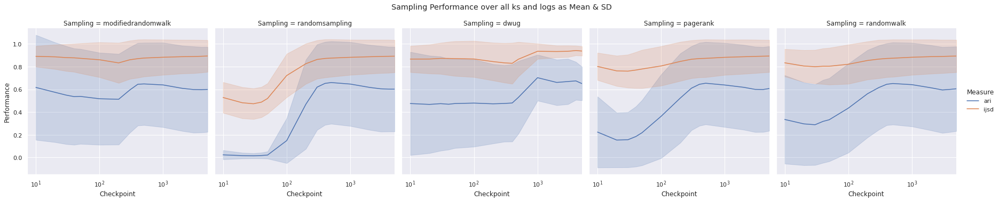

In [38]:
rp = sns.relplot(data=df_sampling_allk_alllog,
    x='Checkpoint', y='Performance', hue='Measure', col='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.85)
rp.fig.suptitle('Sampling Performance over all ks and logs as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

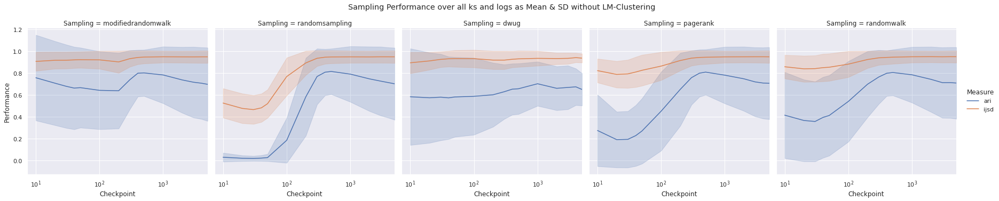

In [39]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_allk_alllog = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_allk_alllog.head()
rp = sns.relplot(data=df_sampling_allk_alllog,
    x='Checkpoint', y='Performance', hue='Measure', col='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.85)
rp.fig.suptitle('Sampling Performance over all ks and logs as Mean & SD without LM-Clustering')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [40]:
df_sampling_k_alllog = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_k_alllog.head()

,Checkpoint,Sampling,k,Measure,Performance
0,10,modifiedrandomwalk,3,ari,1.000000
1,20,modifiedrandomwalk,3,ari,1.000000
2,30,modifiedrandomwalk,3,ari,0.000000
3,40,modifiedrandomwalk,3,ari,-0.061798
4,50,modifiedrandomwalk,3,ari,-0.034217


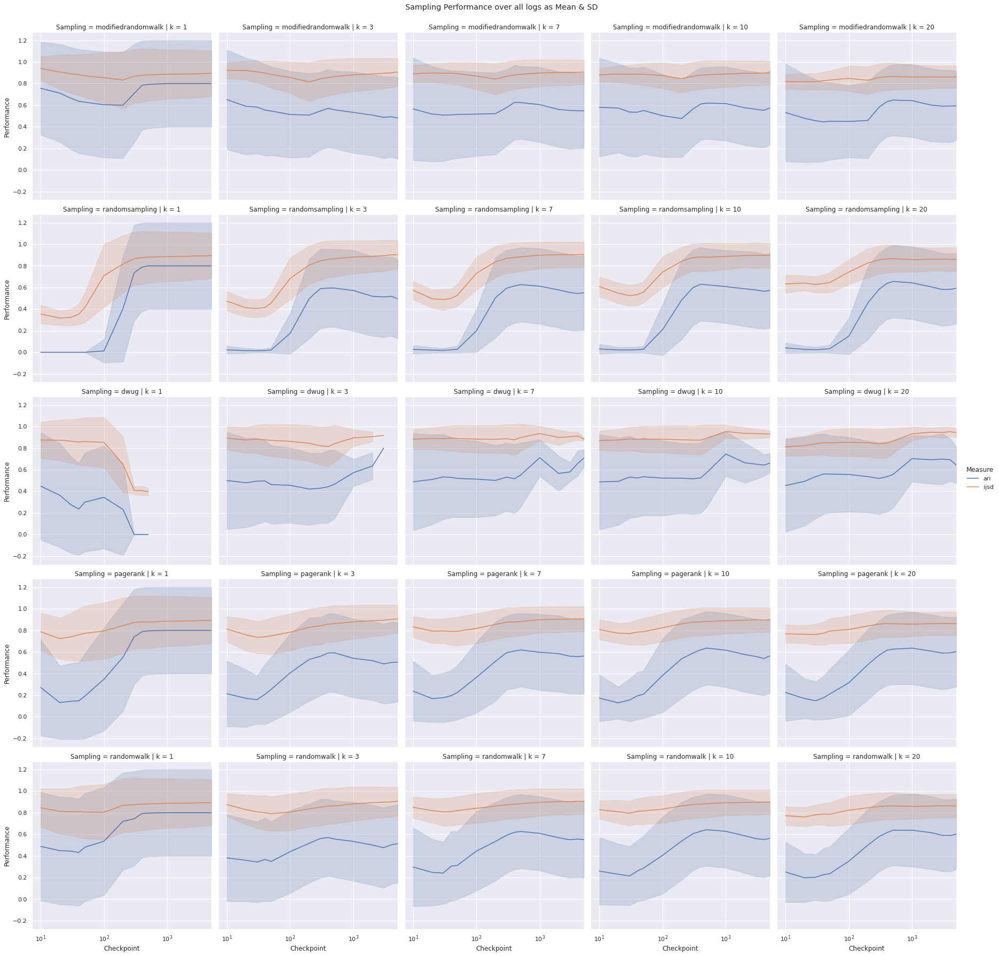

In [41]:
rp = sns.relplot(data=df_sampling_k_alllog,
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance over all logs as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [42]:
dwug_k1_ari = df_sampling_k_alllog.query('Sampling == "dwug" and k == 1 and Measure == "ari"')
dwug_k1_jsd = df_sampling_k_alllog.query('Sampling == "dwug" and k == 1 and Measure == "ijsd"')
dwug_k1_ari.head()

,Checkpoint,Sampling,k,Measure,Performance
362,10,dwug,1,ari,0.0
363,20,dwug,1,ari,0.0
364,30,dwug,1,ari,1.0
365,40,dwug,1,ari,0.0
366,50,dwug,1,ari,0.0


In [43]:
dwug_k1_jsd.head()

,Checkpoint,Sampling,k,Measure,Performance
87150,10,dwug,1,ijsd,0.604184
87151,20,dwug,1,ijsd,0.958797
87152,30,dwug,1,ijsd,1.000000
87153,40,dwug,1,ijsd,0.837880
87154,50,dwug,1,ijsd,0.972176


In [44]:
print('ARI', [dwug_k1_ari[dwug_k1_ari.Checkpoint == i]['Performance'].mean() for i in checkpoints])
print('IJSD', [dwug_k1_jsd[dwug_k1_jsd.Checkpoint == i]['Performance'].mean() for i in checkpoints])

ARI [0.448, 0.364, 0.276, 0.236, 0.3, 0.34439834024896265, 0.23232323232323232, 0.0, 0.0, 0.0, nan, nan, nan, nan, nan]
IJSD [0.8748708304918956, 0.8736176007783635, 0.8650159630895039, 0.8569987183207245, 0.8611327330555777, 0.8535372657752117, 0.6509842206468267, 0.40734336618571887, 0.4053759806236238, 0.3962266615885178, nan, nan, nan, nan, nan]


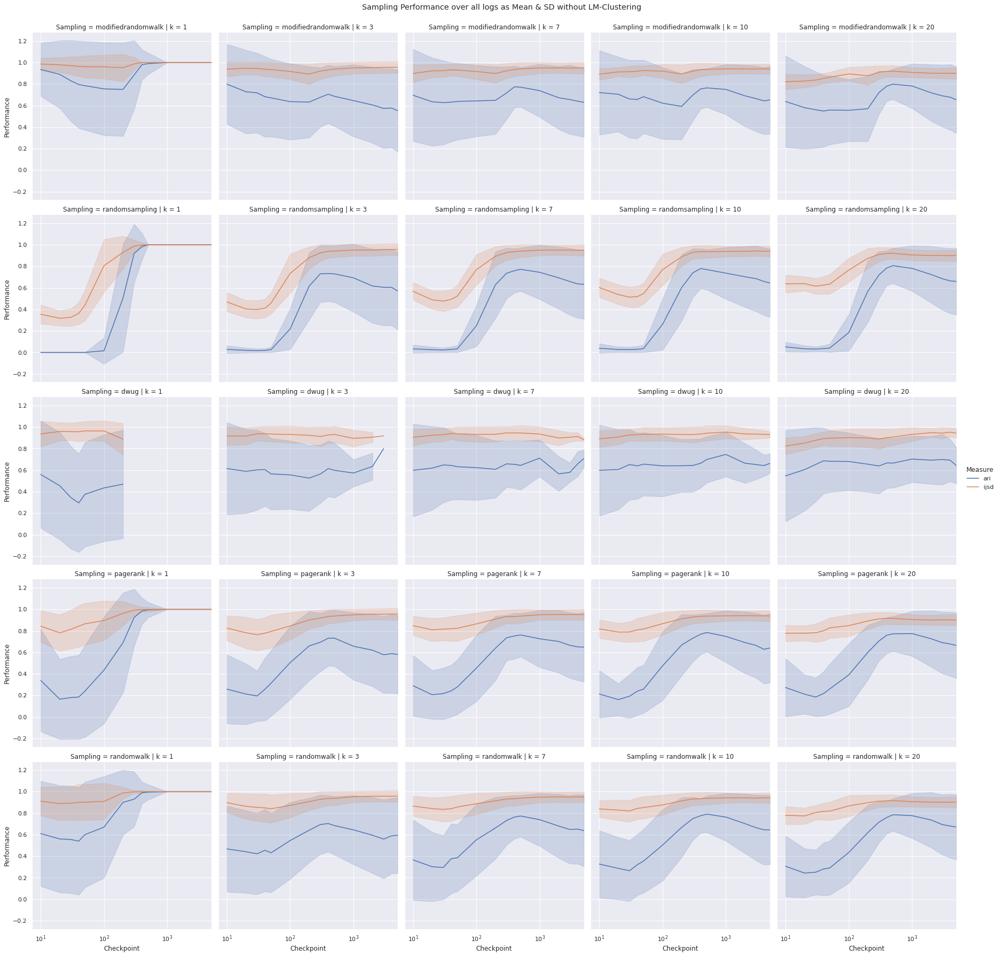

In [45]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_k_alllog = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
rp = sns.relplot(data=df_sampling_k_alllog,
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance over all logs as Mean & SD without LM-Clustering')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [46]:
df_sampling_k_cn = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'k'], value_vars=['cluster_number'], var_name='Measure', value_name='Cluster Number')
df_sampling_k_cn.head()

,Checkpoint,Sampling,k,Measure,Cluster Number
0,10,modifiedrandomwalk,3,cluster_number,1
1,20,modifiedrandomwalk,3,cluster_number,1
2,30,modifiedrandomwalk,3,cluster_number,3
3,40,modifiedrandomwalk,3,cluster_number,2
4,50,modifiedrandomwalk,3,cluster_number,3


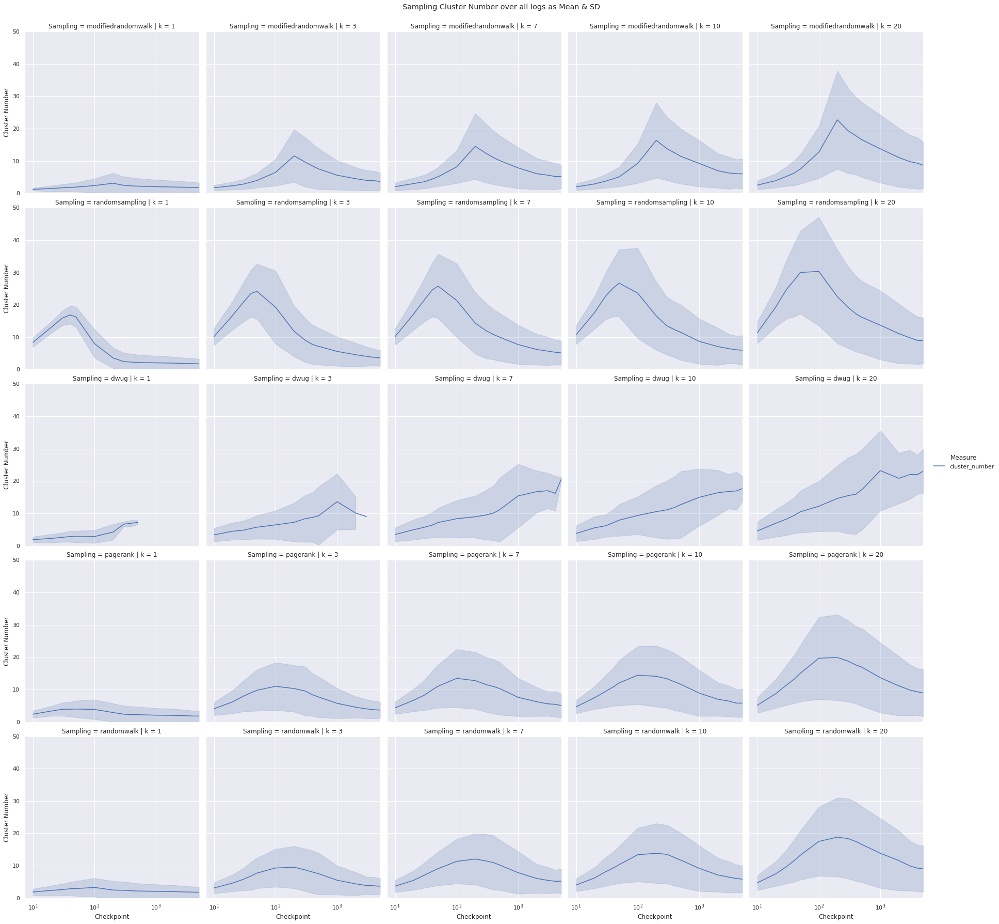

In [47]:
rp = sns.relplot(data=df_sampling_k_cn,
    x='Checkpoint', y='Cluster Number', hue='Measure', col='k', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Cluster Number over all logs as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])
rp.set(ylim=[0, 50])

In [48]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_k_cn_rm_lm = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling', 'k'], value_vars=['cluster_number'], var_name='Measure', value_name='Cluster Number')
df_sampling_k_cn_rm_lm.head()

,Checkpoint,Sampling,k,Measure,Cluster Number
0,10,modifiedrandomwalk,3,cluster_number,1
1,20,modifiedrandomwalk,3,cluster_number,1
2,30,modifiedrandomwalk,3,cluster_number,3
3,40,modifiedrandomwalk,3,cluster_number,2
4,50,modifiedrandomwalk,3,cluster_number,3


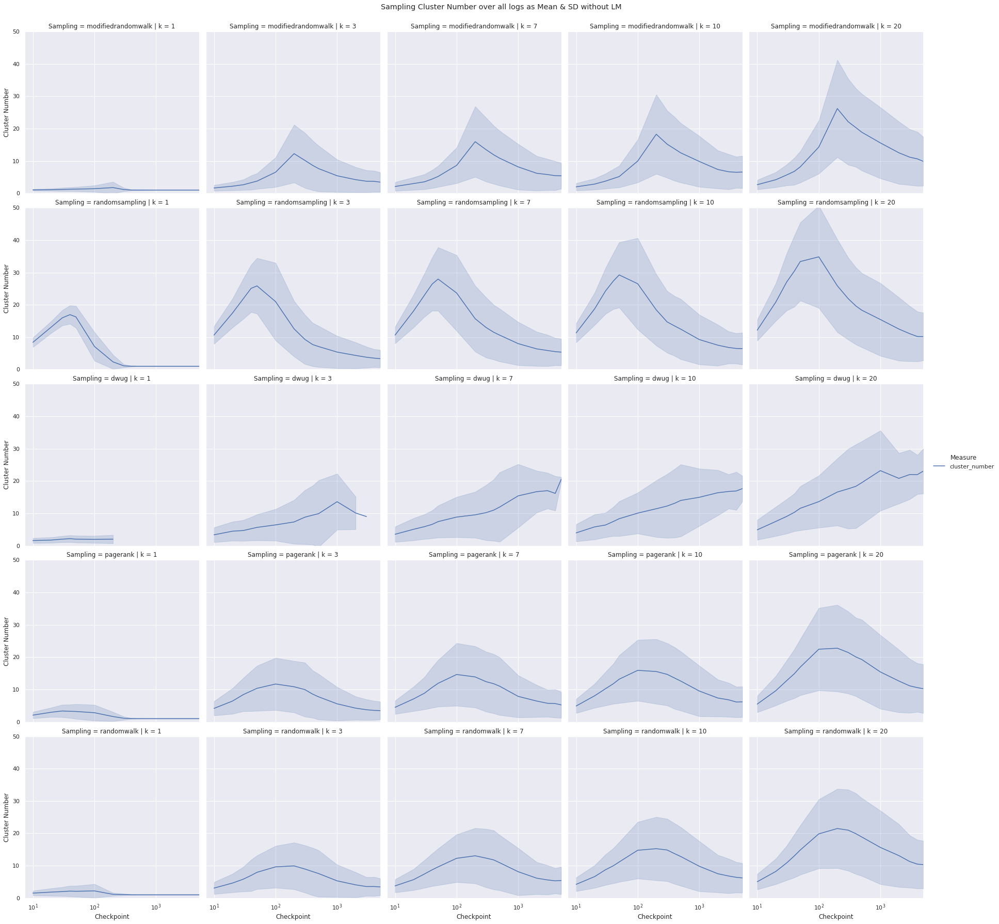

In [49]:
rp = sns.relplot(data=df_sampling_k_cn_rm_lm,
    x='Checkpoint', y='Cluster Number', hue='Measure', col='k', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Cluster Number over all logs as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])
rp.set(ylim=[0, 50])

In [50]:
df_sampling_allk_log = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_allk_log.head()

,Checkpoint,Sampling,log,Measure,Performance
0,10,modifiedrandomwalk,0.3,ari,1.000000
1,20,modifiedrandomwalk,0.3,ari,1.000000
2,30,modifiedrandomwalk,0.3,ari,0.000000
3,40,modifiedrandomwalk,0.3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,ari,-0.034217


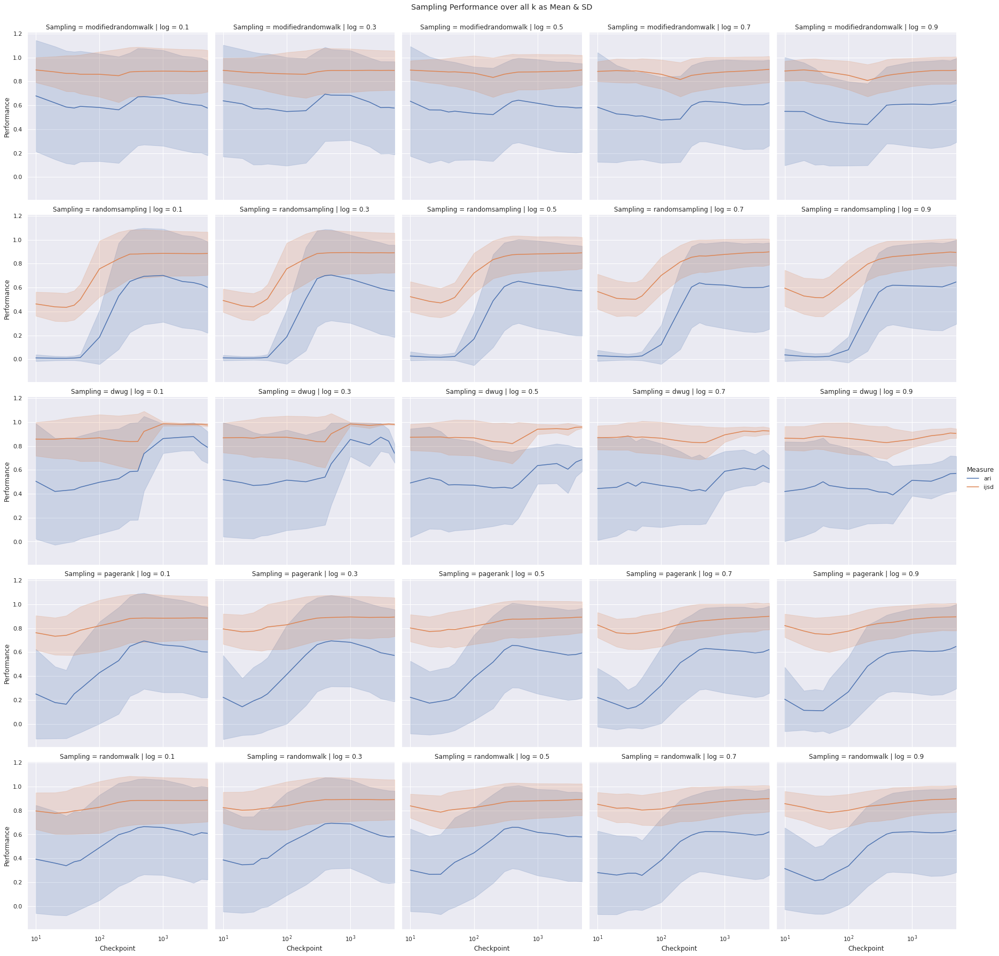

In [51]:
rp = sns.relplot(data=df_sampling_allk_log,
    x='Checkpoint', y='Performance', hue='Measure', col='log', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance over all k as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

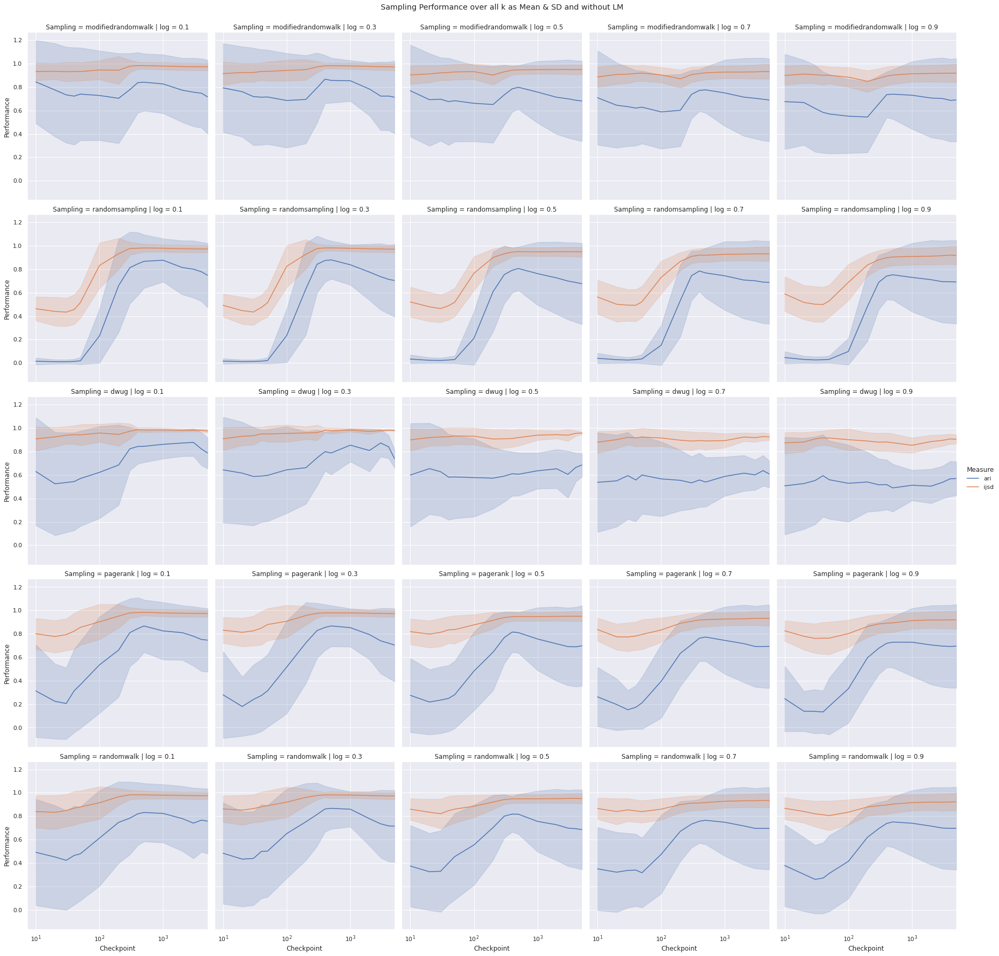

In [52]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_allk_log = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling', 'log'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')

rp = sns.relplot(data=df_sampling_allk_log,
    x='Checkpoint', y='Performance', hue='Measure', col='log', row='Sampling', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance over all k as Mean & SD and without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [53]:
df_sampling_k_log = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_k_log.head()

,Checkpoint,Sampling,log,k,Measure,Performance
0,10,modifiedrandomwalk,0.3,3,ari,1.000000
1,20,modifiedrandomwalk,0.3,3,ari,1.000000
2,30,modifiedrandomwalk,0.3,3,ari,0.000000
3,40,modifiedrandomwalk,0.3,3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,3,ari,-0.034217


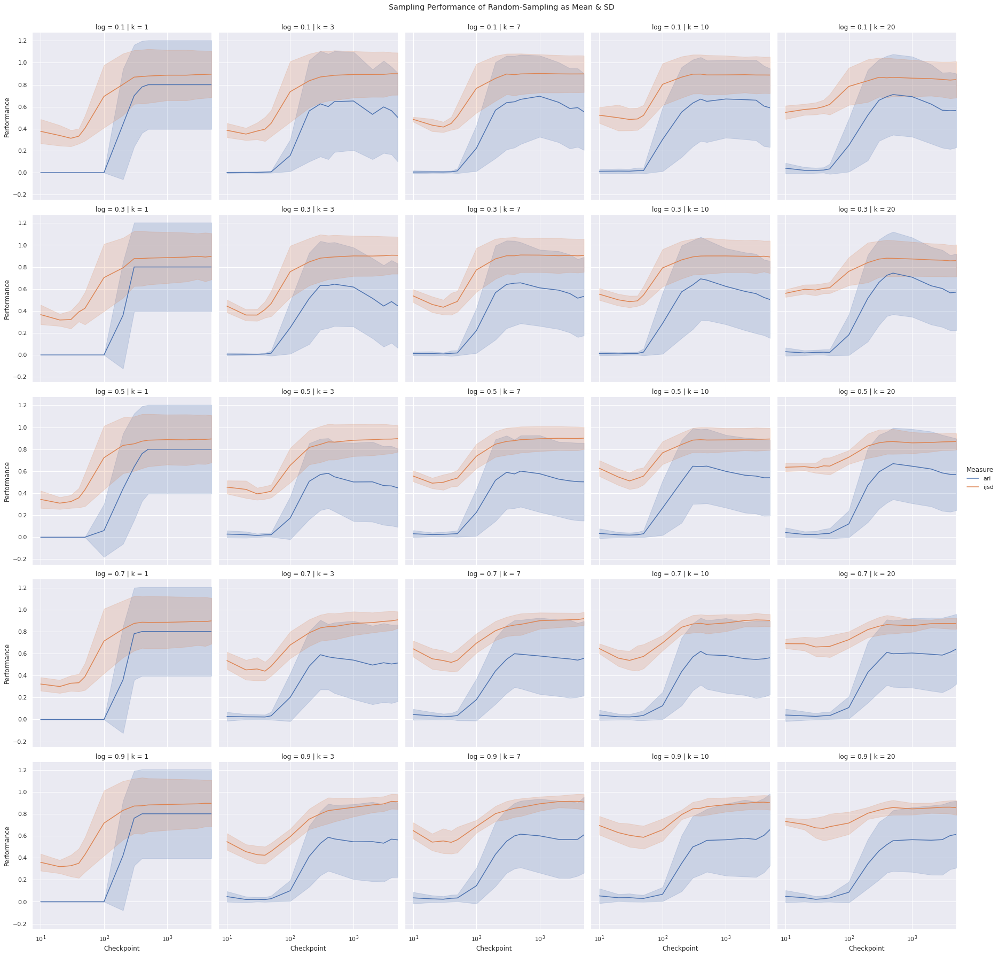

In [54]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "randomsampling"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of Random-Sampling as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

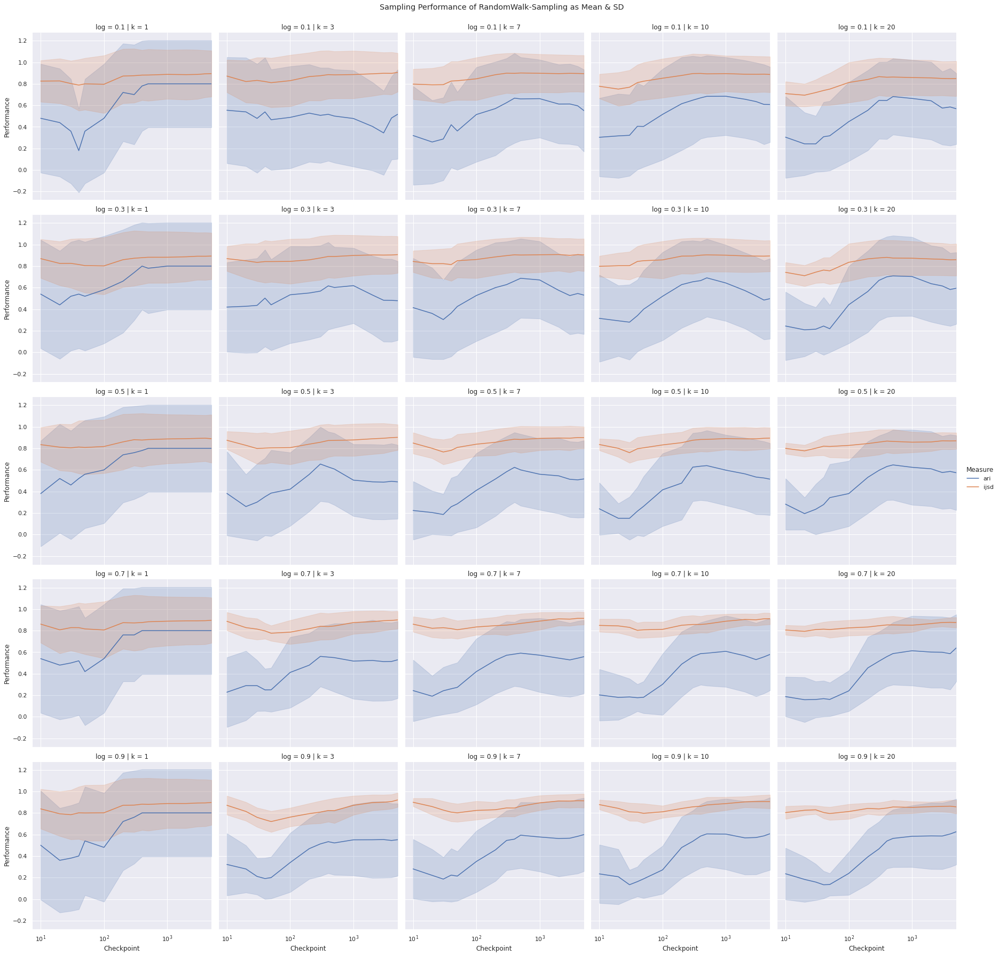

In [55]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "randomwalk"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of RandomWalk-Sampling as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

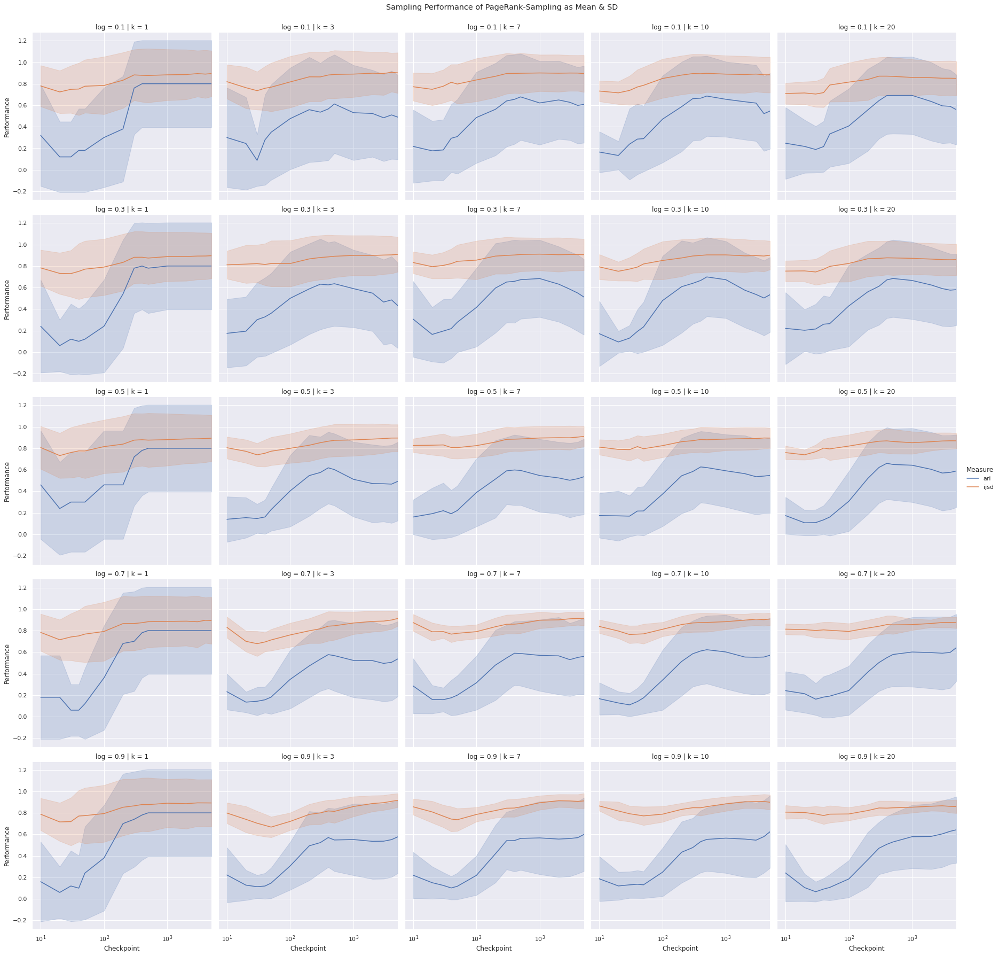

In [56]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "pagerank"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of PageRank-Sampling as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

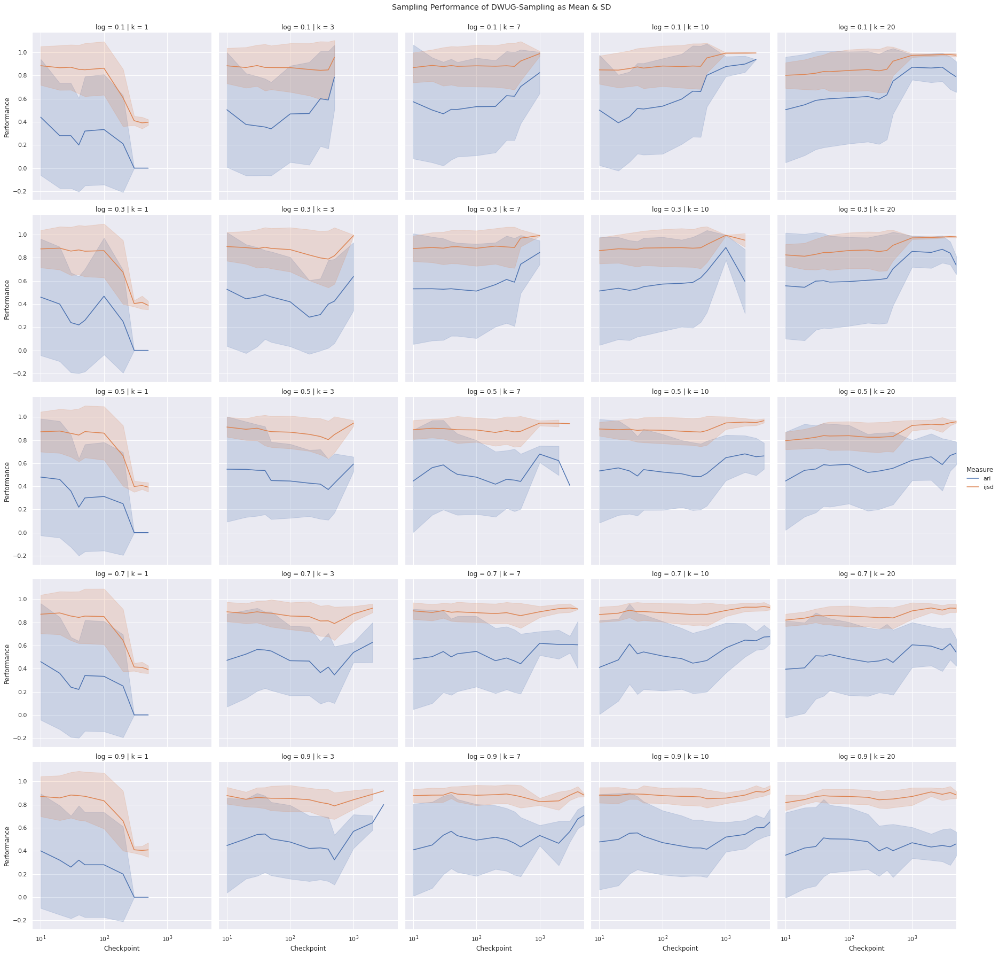

In [57]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "dwug"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of DWUG-Sampling as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [58]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_k_log = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_k_log.head()

,Checkpoint,Sampling,log,k,Measure,Performance
0,10,modifiedrandomwalk,0.3,3,ari,1.000000
1,20,modifiedrandomwalk,0.3,3,ari,1.000000
2,30,modifiedrandomwalk,0.3,3,ari,0.000000
3,40,modifiedrandomwalk,0.3,3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,3,ari,-0.034217


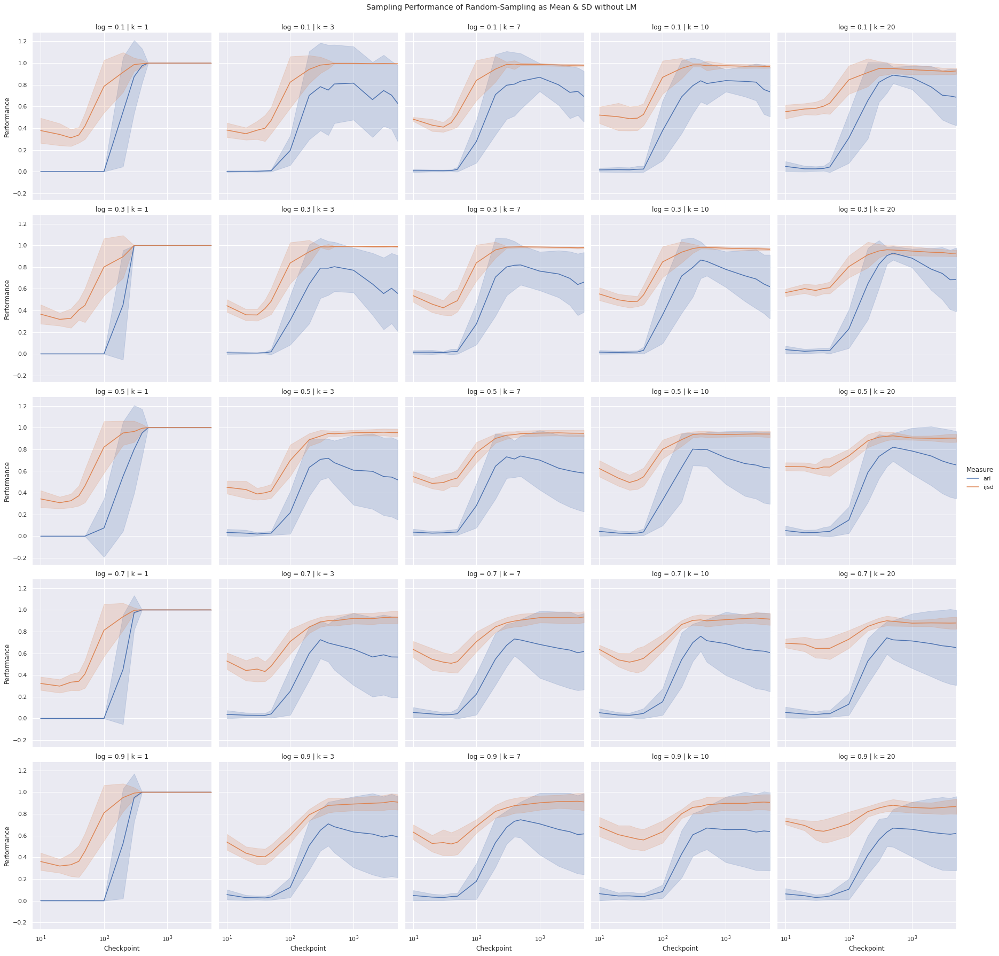

In [59]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "randomsampling"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of Random-Sampling as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

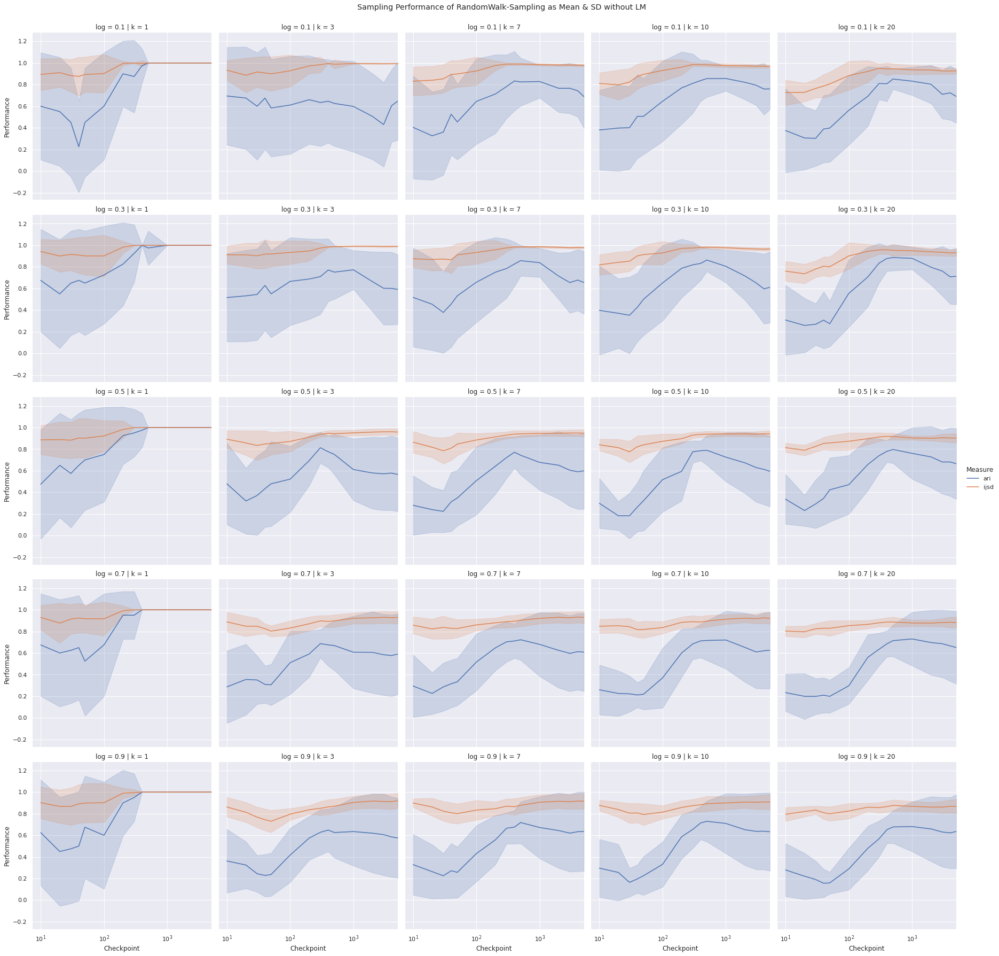

In [60]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "randomwalk"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of RandomWalk-Sampling as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

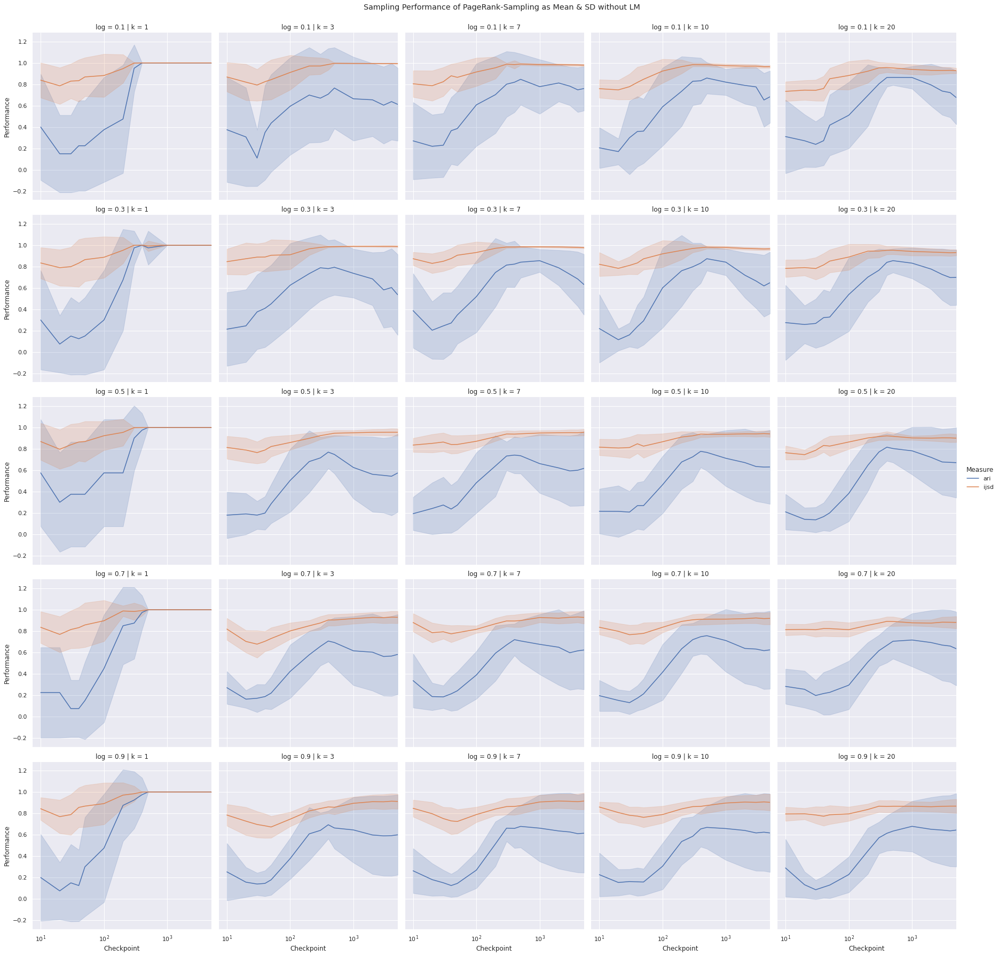

In [61]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "pagerank"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of PageRank-Sampling as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

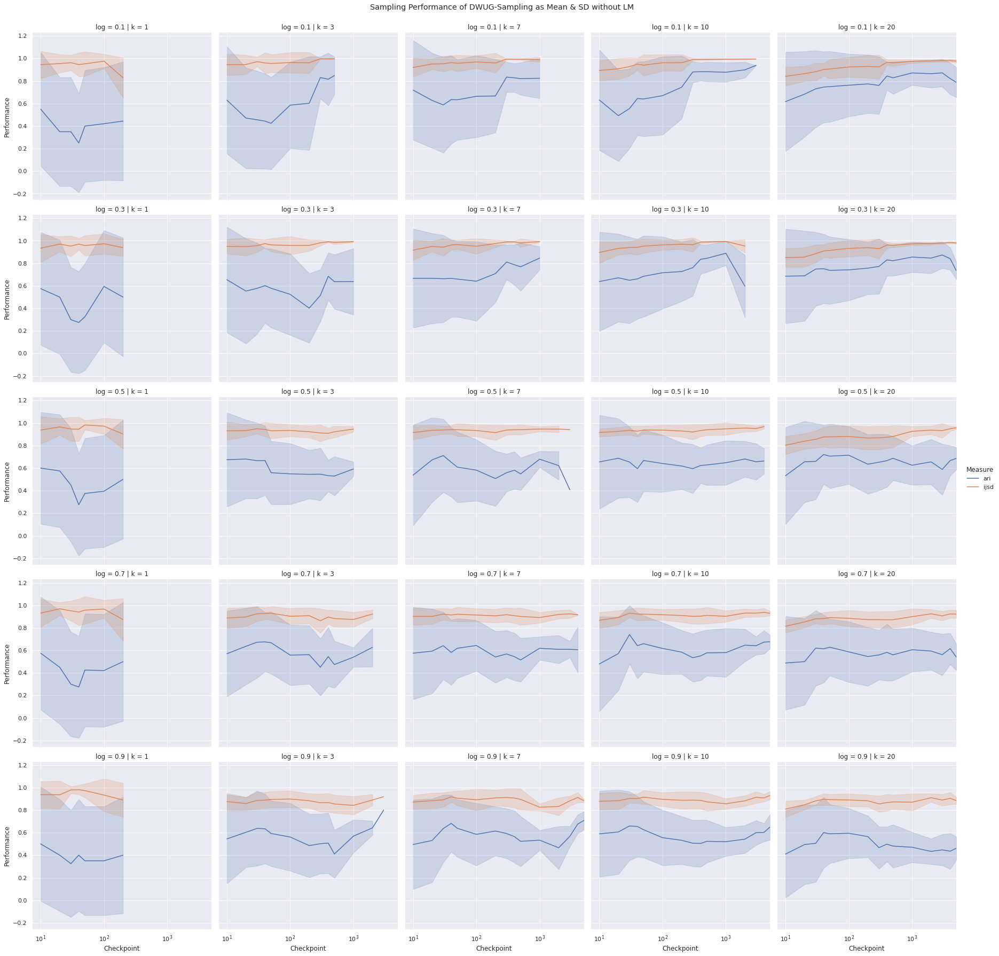

In [62]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "dwug"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of DWUG-Sampling as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [63]:
df_sampling = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari'], var_name='Measure', value_name='Performance')
df_sampling.head()

,Checkpoint,Sampling,log,k,Measure,Performance
0,10,modifiedrandomwalk,0.3,3,ari,1.000000
1,20,modifiedrandomwalk,0.3,3,ari,1.000000
2,30,modifiedrandomwalk,0.3,3,ari,0.000000
3,40,modifiedrandomwalk,0.3,3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,3,ari,-0.034217


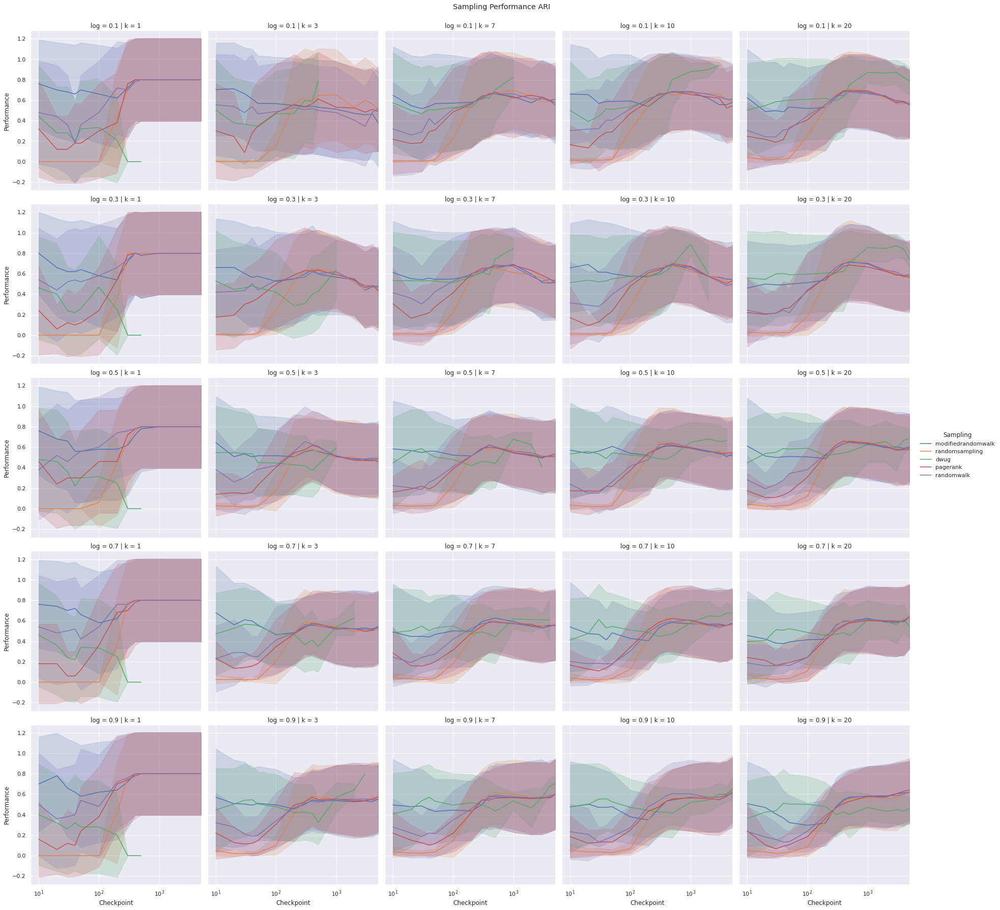

In [64]:
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Performance', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance ARI')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

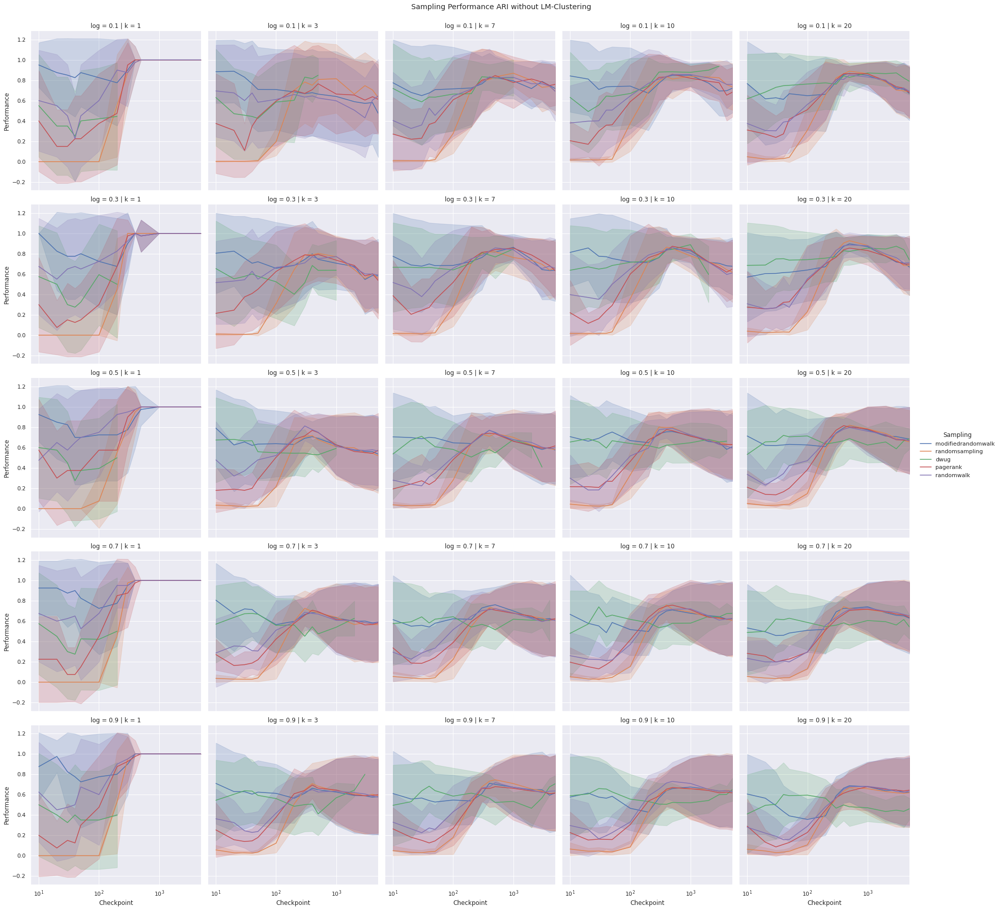

In [65]:
df_wo_lm = df.query('Clustering != "lm"')
df_sampling = pd.melt(df_wo_lm, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari'], var_name='Measure', value_name='Performance')
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Performance', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance ARI without LM-Clustering')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

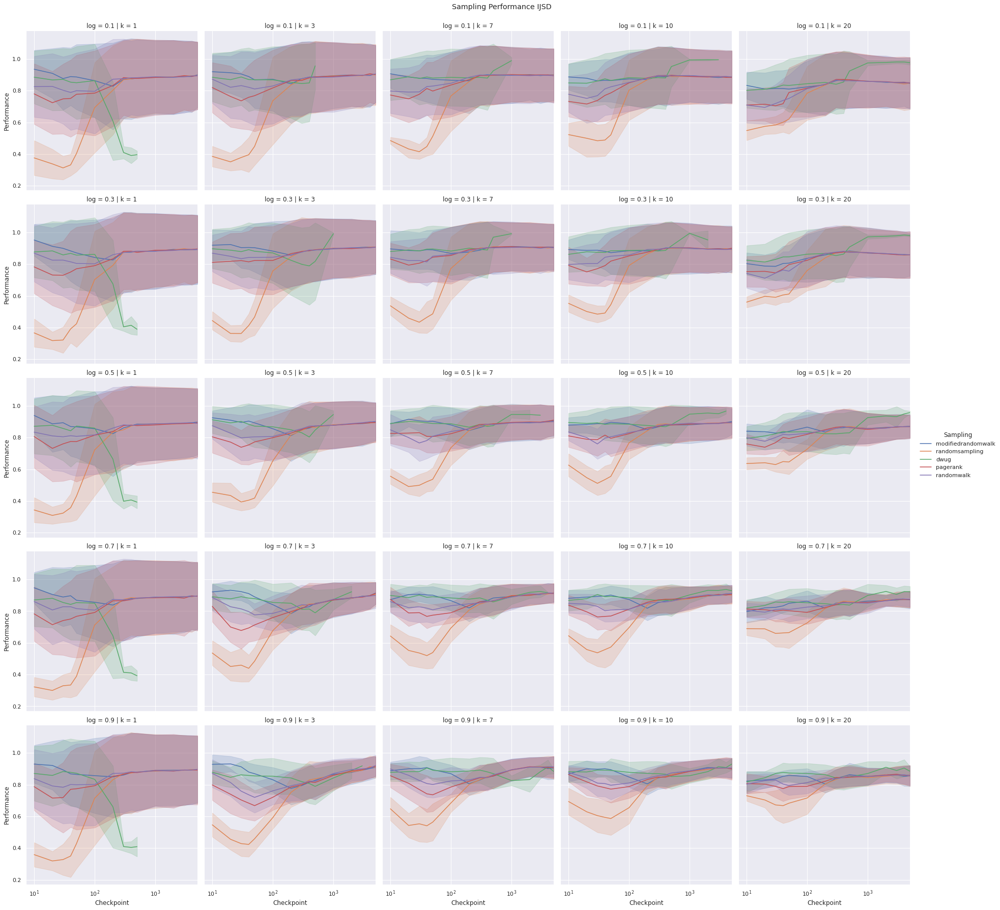

In [66]:
df_sampling = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ijsd'], var_name='Measure', value_name='Performance')
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Performance', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance IJSD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

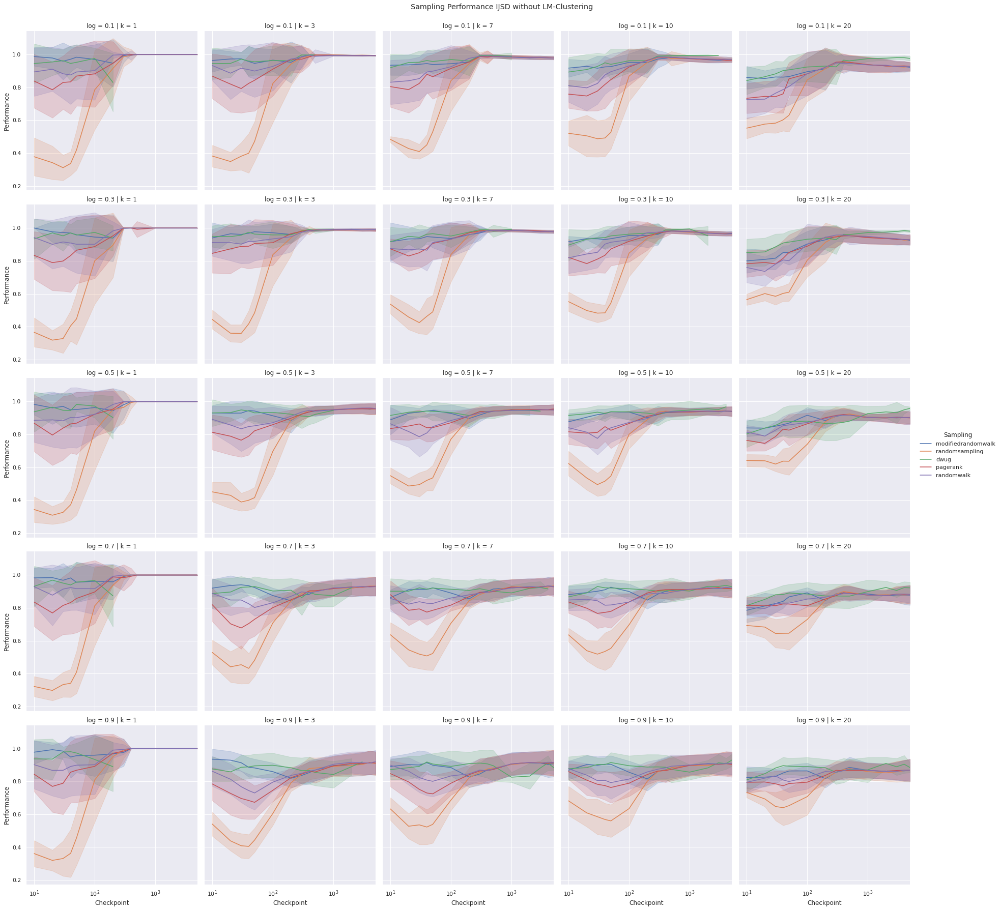

In [67]:
df_sampling = pd.melt(df_wo_lm, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ijsd'], var_name='Measure', value_name='Performance')
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Performance', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance IJSD without LM-Clustering')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

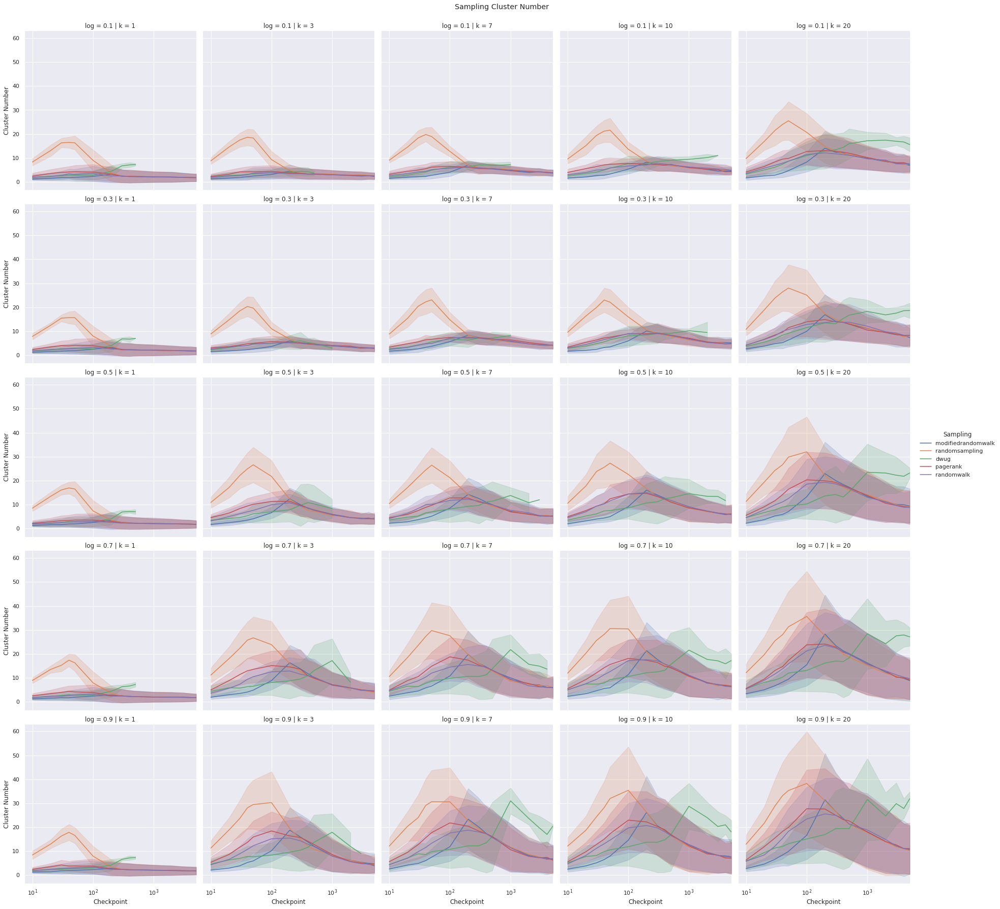

In [68]:
df_sampling = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['cluster_number'], var_name='Measure', value_name='Cluster Number')
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Cluster Number', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Cluster Number')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

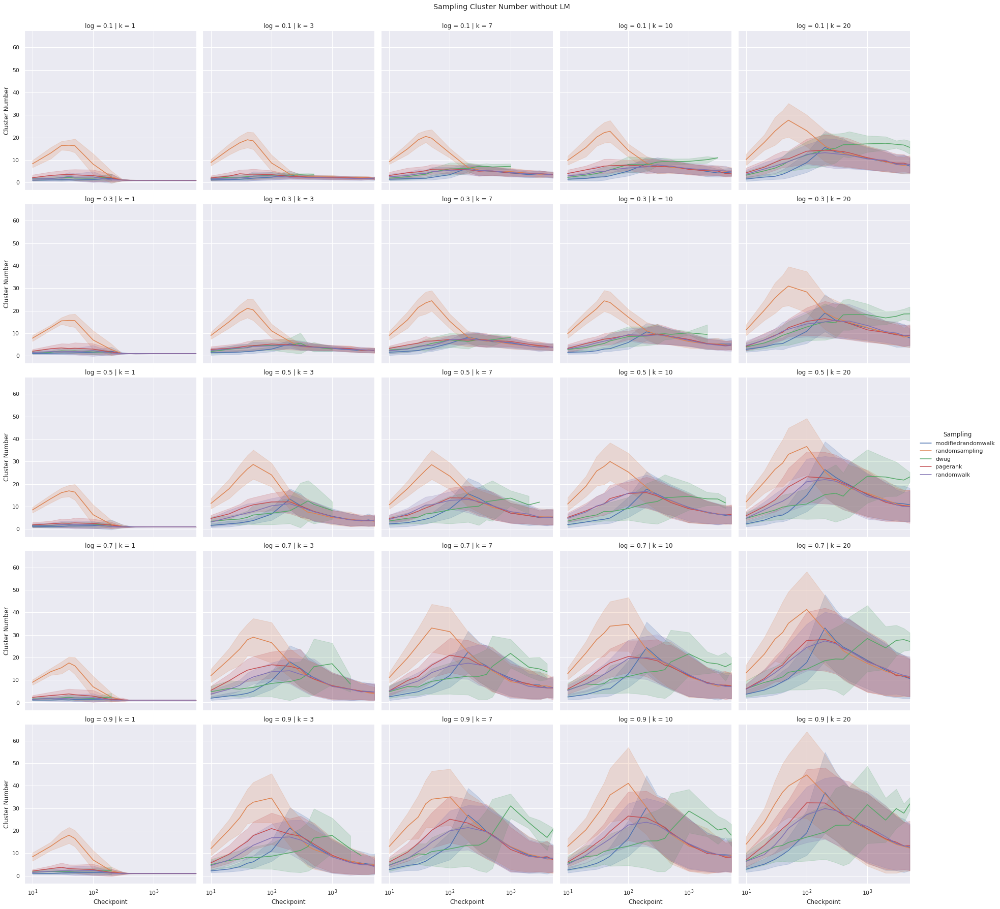

In [69]:
df_sampling = pd.melt(df_wo_lm, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['cluster_number'], var_name='Measure', value_name='Cluster Number')
rp = sns.relplot(data=df_sampling,
    x='Checkpoint', y='Cluster Number', hue='Sampling', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Cluster Number without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [70]:
df_sampling_k_log = pd.melt(df, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_k_log.head()

,Checkpoint,Sampling,log,k,Measure,Performance
0,10,modifiedrandomwalk,0.3,3,ari,1.000000
1,20,modifiedrandomwalk,0.3,3,ari,1.000000
2,30,modifiedrandomwalk,0.3,3,ari,0.000000
3,40,modifiedrandomwalk,0.3,3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,3,ari,-0.034217


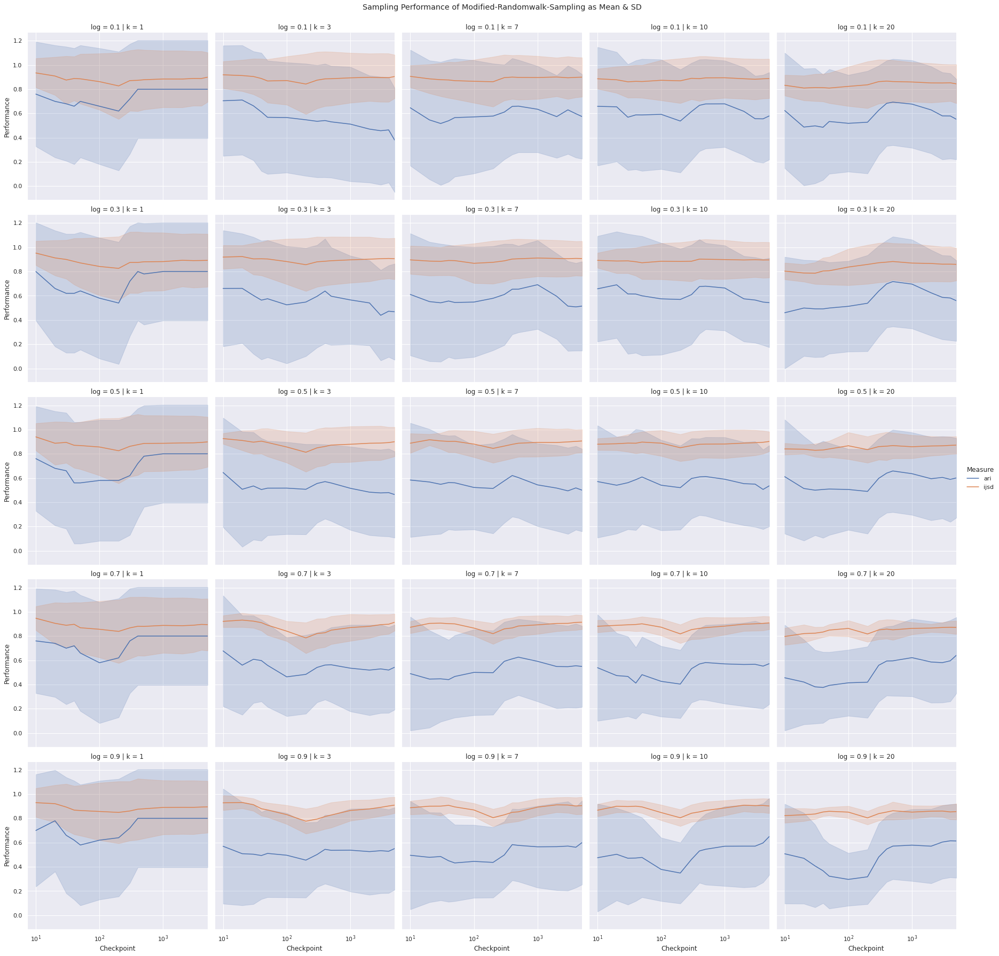

In [71]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "modifiedrandomwalk"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of Modified-Randomwalk-Sampling as Mean & SD')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])

In [72]:
rm_lm = df.query('Clustering != "lm"')
df_sampling_k_log = pd.melt(rm_lm, id_vars=['Checkpoint', 'Sampling', 'log', 'k'], value_vars=['ari', 'ijsd'], var_name='Measure', value_name='Performance')
df_sampling_k_log.head()

,Checkpoint,Sampling,log,k,Measure,Performance
0,10,modifiedrandomwalk,0.3,3,ari,1.000000
1,20,modifiedrandomwalk,0.3,3,ari,1.000000
2,30,modifiedrandomwalk,0.3,3,ari,0.000000
3,40,modifiedrandomwalk,0.3,3,ari,-0.061798
4,50,modifiedrandomwalk,0.3,3,ari,-0.034217


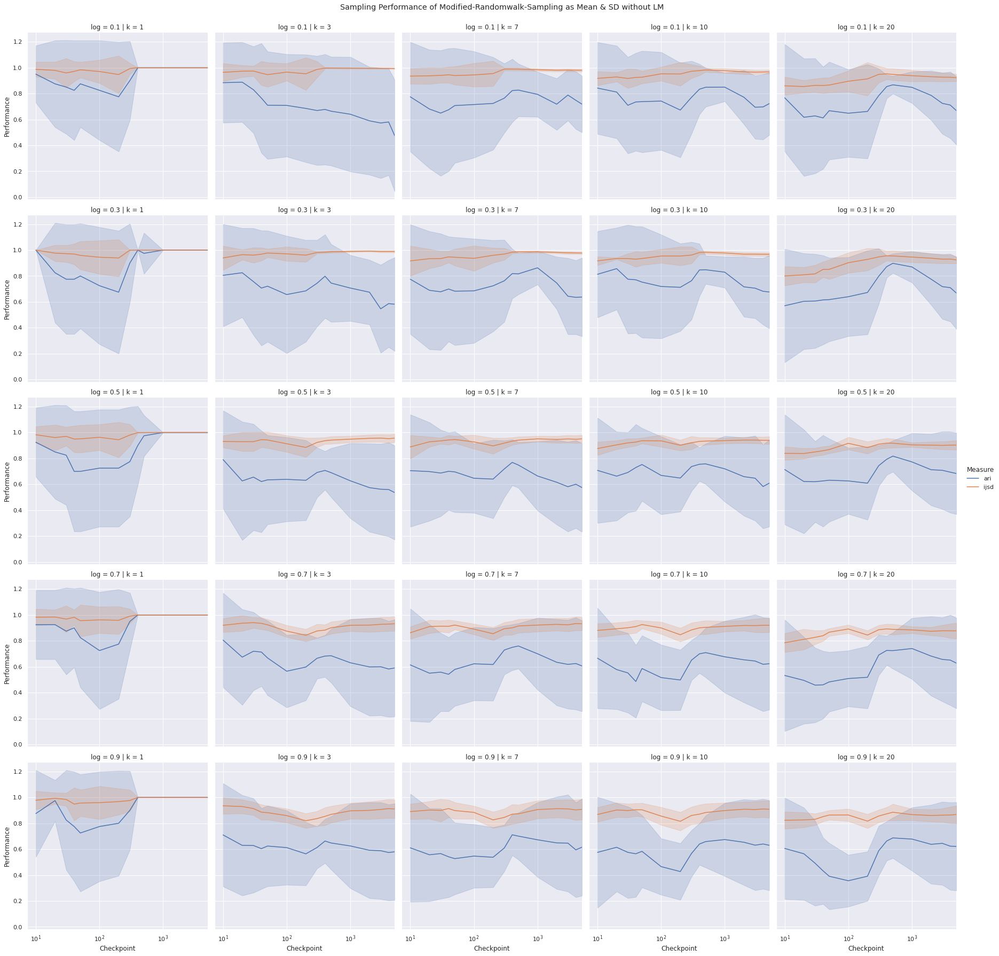

In [73]:
rp = sns.relplot(data=df_sampling_k_log.query('Sampling == "modifiedrandomwalk"'),
    x='Checkpoint', y='Performance', hue='Measure', col='k', row='log', ci='sd', kind='line')

rp.fig.subplots_adjust(top=0.95)
rp.fig.suptitle('Sampling Performance of Modified-Randomwalk-Sampling as Mean & SD without LM')
rp.set(xscale='log')
rp.set(xlim=[0, 5000])